[source](https://towardsdatascience.com/audio-deep-learning-made-simple-sound-classification-step-by-step-cebc936bbe5)

In [70]:
import pandas as pd
import os
import numpy as np
import IPython.display as ipd


import random
import torch
import torchaudio
from torchaudio import transforms
from torch.utils.data import DataLoader, Dataset

from torch import nn


from matplotlib import pyplot as plt
import seaborn as sns


import librosa
import librosa.display

import warnings

warnings.filterwarnings("ignore")


In [71]:
def play_audio(path):
  return ipd.display(ipd.Audio(path))

In [72]:
download_path = 'IRMAS'

In [73]:
folders = sorted(os.listdir(f"{download_path}/IRMAS-TrainingData/"))

In [74]:
classeID=['cello', 'clarinet', 'flute', 'acoustic guitar', 'electric guitar', 'organ',
          'piano', 'saxophone', 'trumpet', 'violin', 'voice']

labels_dict={'cel':0,
             'cla':1,
             'flu':2,
             'gac':3,
             'gel':4,
             'org':5,
             'pia':6,
             'sax':7,
             'tru':8,
             'vio':9,
             'voi':10}

inverse_dict={}
for key in labels_dict.keys():
    inverse_dict[labels_dict[key]]=key

num_classes=11

files_names=[]
labels_names=[]
num_channels=[]
sample_rates=[]
class_names=[]
#length of signals in seconds
sig_length=[]


#maximum value of amplitude
max_val=[]
#minimum value of amplitude
min_val=[]



folders = sorted(os.listdir(f"{download_path}/IRMAS-TrainingData/"))
for j, folder in enumerate(folders):
    #path=f"{download_path}/IRMAS-TrainingData/"+folder+"/"
    audio_files=os.listdir(f"{download_path}/IRMAS-TrainingData/"+folder+"/")
    for file_name in audio_files:
        files_names.append("/IRMAS-TrainingData/"+folder+"/"+file_name)
        labels=torch.zeros(1,num_classes)
        labels[0,j]=1
        labels_names.append(labels)

        class_names.append(inverse_dict[j])

        #open audio_file
        sig, sr = torchaudio.load(f"{download_path}/IRMAS-TrainingData/"+folder+"/"+file_name)
        #add number of channels in the list
        num_channels.append(sig.shape[0])


        sig_length.append(sig.shape[1]/sr)

        #signal in numpy
        sig_numpy=sig.detach().numpy()

        max_val.append(sig_numpy.max())
        min_val.append(sig_numpy.min())

        #add sample rate
        sample_rates.append(sr)




df=pd.DataFrame({'relative_path': files_names, 'label': labels_names, 'num_channels': num_channels,
                 'sample_rates': sample_rates, 'time_duration': sig_length,
                 'min_val': min_val, 'max_val': max_val, 'class_name': class_names})

df.head()

,relative_path,label,num_channels,sample_rates,time_duration,min_val,max_val,class_name
0,/IRMAS-TrainingData/cel/008__[cel][nod][cla]00...,"[[tensor(1.), tensor(0.), tensor(0.), tensor(0...",2,44100,2.999977,-0.038849,0.039032,cel
1,/IRMAS-TrainingData/cel/008__[cel][nod][cla]00...,"[[tensor(1.), tensor(0.), tensor(0.), tensor(0...",2,44100,2.999977,-0.066742,0.058563,cel
2,/IRMAS-TrainingData/cel/008__[cel][nod][cla]00...,"[[tensor(1.), tensor(0.), tensor(0.), tensor(0...",2,44100,2.999977,-0.110107,0.103485,cel
3,/IRMAS-TrainingData/cel/012__[cel][nod][cla]00...,"[[tensor(1.), tensor(0.), tensor(0.), tensor(0...",2,44100,2.999977,-0.153870,0.151062,cel
4,/IRMAS-TrainingData/cel/012__[cel][nod][cla]00...,"[[tensor(1.), tensor(0.), tensor(0.), tensor(0...",2,44100,2.999977,-0.152161,0.118866,cel


In [75]:
df.shape

(6705, 8)

In [76]:
play_audio(f"{download_path}"+df.iloc[5]['relative_path'])

In [77]:
#все записи из двух каналов
df['num_channels'].value_counts()

2    6705
Name: num_channels, dtype: int64

In [78]:
#все записи имеют частоту 44100 Hz
df['sample_rates'].value_counts()

44100    6705
Name: sample_rates, dtype: int64

In [79]:
#все записи имеют одну и ту же длинну ~ 3 секунд
df['time_duration'].value_counts()

2.999977    6705
Name: time_duration, dtype: int64

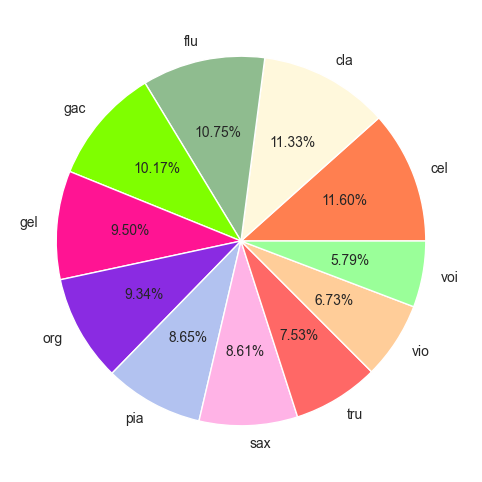

In [80]:
#the least popular class is voice, the most popular is clarnet
plt.figure(figsize=(10,6))
colors= ['#FF7F50','#FFF8DC', '#8FBC8F','#7FFF00', '#FF1493','#8A2BE2', '#b2c2f0','#ffb3e6', '#ff6866', '#ffcd99', '#9aff99']
plt.pie(df['class_name'].value_counts(), labels=df['class_name'].unique(), colors=colors, autopct='%.2f%%');
plt.show()

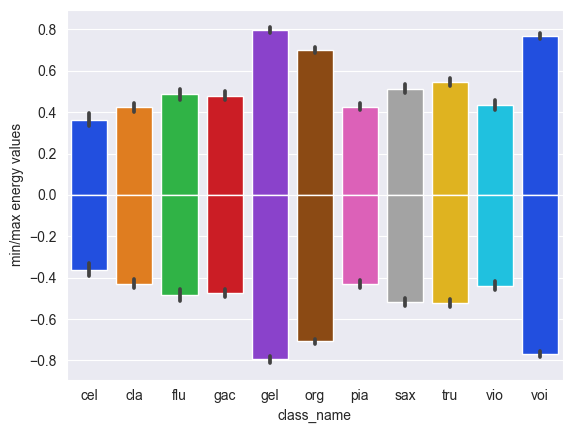

In [81]:
#minimum and maximum amplitude values in records for each instrument
#the more the amplitude the louder the sound
sns.barplot(x = 'class_name', y='max_val', data=df, estimator=np.mean, palette='bright');
sns.barplot(x = 'class_name', y='min_val', data=df, estimator=np.mean, palette='bright');
plt.ylabel("min/max energy values");

### Examples of mel spectrograms

In [82]:
N_FFT=2048
HOP_LENGTH=441
WIN_LENGTH=2048
N_MELS=128

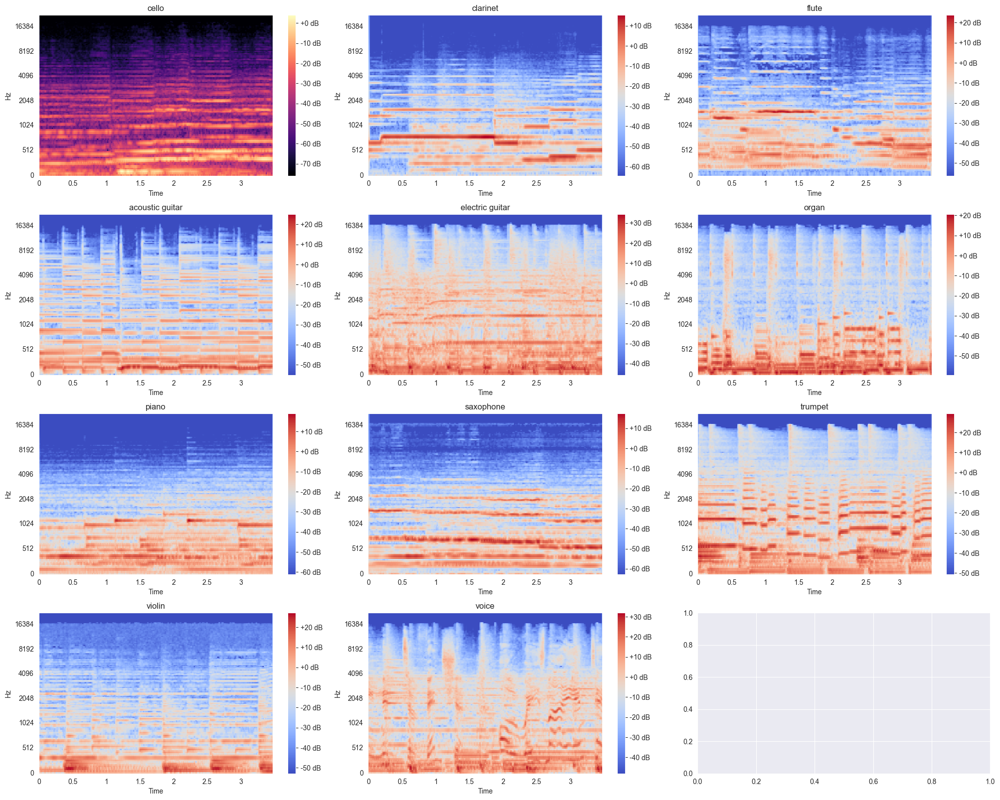

In [83]:
widths=[4,4,4]
heights=[3]*4
gs_kw = dict(width_ratios=widths, height_ratios=heights)
fig, axes= plt.subplots(4, 3, figsize=(20, 16), gridspec_kw=gs_kw)
for i, instr in enumerate(labels_dict.keys()):
    ind=df[df['class_name']==instr].index[0]
    path = f"{download_path}"+df.iloc[ind]['relative_path']
    sig, sr=torchaudio.load(path, format="wav")


    mel_spectrogram = librosa.feature.melspectrogram(sig[0].detach().numpy(), sr=sr, n_fft=N_FFT, hop_length=HOP_LENGTH, n_mels=N_MELS)


    log_mel_spectrogram = librosa.power_to_db(mel_spectrogram)

    img=librosa.display.specshow(log_mel_spectrogram,
                         x_axis="time",
                         y_axis="mel",
                         sr=sr,
                         ax=axes[i//3, i%3])


    axes[i//3, i%3].set_title('{}'.format(classeID[labels_dict[instr]]))
    plt.colorbar(img, format="%+2.0f dB")



plt.tight_layout(pad=0.5, w_pad=0.5, h_pad=1.0)

In [84]:
class AudioUtil():
  # ----------------------------
  # Load an audio file. Return the signal as a tensor and the sample rate
  # ----------------------------
  @staticmethod
  def open(audio_file):
    sig, sr = torchaudio.load(audio_file)
    #sig - signal
    #sr - sample rate (samples per second (Htz))
    return (sig, sr)


# Convert the given audio to the desired number of channels
  @staticmethod
  def rechannel(aud, new_channel):
    sig, sr = aud

    if (sig.shape[0] == new_channel):
      # Nothing to do
      return aud

    if (new_channel == 1):
      # Convert from stereo to mono by selecting only the first channel
      resig = sig[:1, :]
    else:
      # Convert from mono to stereo by duplicating the first channel
      resig = torch.cat([sig, sig])

    return ((resig, sr))


# ----------------------------
  # Since Resample applies to a single channel, we resample one channel at a time
  # ----------------------------
  @staticmethod
  def resample(aud, newsr):
    sig, sr = aud

    if (sr == newsr):
      # Nothing to do
      return aud

    num_channels = sig.shape[0]
    # Resample first channel
    resig = torchaudio.transforms.Resample(sr, newsr)(sig[:1,:])
    if (num_channels > 1):
      # Resample the second channel and merge both channels
      retwo = torchaudio.transforms.Resample(sr, newsr)(sig[1:,:])
      resig = torch.cat([resig, retwo])

    return ((resig, newsr))

  # ----------------------------
  # Pad (or truncate) the signal to a fixed length 'max_ms' in milliseconds
  # ----------------------------
  @staticmethod
  def pad_trunc(aud, max_ms):
    sig, sr = aud
    num_rows, sig_len = sig.shape
    max_len = sr//1000 * max_ms

    if (sig_len > max_len):
      # Truncate the signal to the given length
      sig = sig[:,:max_len]

    elif (sig_len < max_len):
      # Length of padding to add at the beginning and end of the signal
      pad_begin_len = random.randint(0, max_len - sig_len)
      pad_end_len = max_len - sig_len - pad_begin_len

      # Pad with 0s
      pad_begin = torch.zeros((num_rows, pad_begin_len))
      pad_end = torch.zeros((num_rows, pad_end_len))

      sig = torch.cat((pad_begin, sig, pad_end), 1)

    return (sig, sr)

  # ----------------------------
  # Shifts the signal to the left or right by some percent. Values at the end
  # are 'wrapped around' to the start of the transformed signal.
  # ----------------------------
  @staticmethod
  def time_shift(aud, shift_limit):
    sig,sr = aud
    _, sig_len = sig.shape
    shift_amt = int(random.random() * shift_limit * sig_len)
    return (sig.roll(shift_amt), sr)

  # ----------------------------
  # Generate a Spectrogram
  # ----------------------------
  @staticmethod
  def spectro_gram(aud, n_mels, n_fft, hop_len=None, win_length=None):
    sig,sr = aud
    top_db = 80

    # spec has shape [channel, n_mels, time], where channel is mono, stereo etc
    spec = transforms.MelSpectrogram(sr, n_fft=n_fft, hop_length=hop_len, n_mels=n_mels, win_length=win_length)(sig)

    # Convert to decibels
    spec = transforms.AmplitudeToDB(top_db=top_db)(spec)
    return (spec)

  # ----------------------------
  # Augment the Spectrogram by masking out some sections of it in both the frequency
  # dimension (ie. horizontal bars) and the time dimension (vertical bars) to prevent
  # overfitting and to help the model generalise better. The masked sections are
  # replaced with the mean value.
  # ----------------------------
  @staticmethod
  def spectro_augment(spec, max_mask_pct=0.1, n_freq_masks=1, n_time_masks=1):
    _, n_mels, n_steps = spec.shape
    mask_value = spec.mean()
    aug_spec = spec

    freq_mask_param = max_mask_pct * n_mels
    for _ in range(n_freq_masks):
      aug_spec = transforms.FrequencyMasking(freq_mask_param)(aug_spec, mask_value)

    time_mask_param = max_mask_pct * n_steps
    for _ in range(n_time_masks):
      aug_spec = transforms.TimeMasking(time_mask_param)(aug_spec, mask_value)

    return aug_spec


In [85]:
#prepare custom dataset of audiofiles
# ----------------------------
# Sound Dataset
# ----------------------------
class SoundDS(Dataset):
  def __init__(self, df, data_path):
    self.df = df
    self.data_path = str(data_path)
    self.duration = 3000 #3 sec
    self.sr = 44100 #44,1 kHz
    self.channel = 2
    self.shift_pct = 0.4

  # ----------------------------
  # Number of items in dataset
  # ----------------------------
  def __len__(self):
    return len(self.df)

  # ----------------------------
  # Get i'th item in dataset
  # ----------------------------
  def __getitem__(self, idx):
    # Absolute file path of the audio file - concatenate the audio directory with
    # the relative path
    audio_file = self.data_path + self.df.loc[idx, 'relative_path']
    # Get the Class ID
    class_id = self.df.loc[idx, 'label']

    #print(audio_file)
    aud = AudioUtil.open(audio_file)
    # Some sounds have a higher sample rate, or fewer channels compared to the
    # majority. So make all sounds have the same number of channels and same
    # sample rate. Unless the sample rate is the same, the pad_trunc will still
    # result in arrays of different lengths, even though the sound duration is
    # the same.

    #not need to resample and rechannel as we have 44100 Htz and 2 channels
    #reaud = AudioUtil.resample(aud, self.sr)
    #rechan = AudioUtil.rechannel(reaud, self.channel)



    dur_aud = AudioUtil.pad_trunc(aud, self.duration)  #rechan
    shift_aud = AudioUtil.time_shift(dur_aud, self.shift_pct)
    sgram = AudioUtil.spectro_gram(shift_aud, n_mels=N_MELS, n_fft=N_FFT, hop_len=HOP_LENGTH, win_length=WIN_LENGTH)


    #framesize = win_length
    #size of mel spectrogram =(n_mels, #frames in time domain) = (n_mels, sr*duration/hop_length) = (128, 3*41100/441) = (128, 300)








    aug_sgram = AudioUtil.spectro_augment(sgram, max_mask_pct=0.1, n_freq_masks=2, n_time_masks=2)

    return aug_sgram, class_id

In [86]:
BATCH_SIZE=32

In [87]:
from torch.utils.data import random_split


data_path='IRMAS'
myds = SoundDS(df, data_path)

# Random split of 80:20 between training and validation
num_items = len(myds)
num_train = round(num_items * 0.8)
num_val = num_items - num_train
train_ds, val_ds = random_split(myds, [num_train, num_val])

# Create training and validation data loaders
train_dl = torch.utils.data.DataLoader(train_ds, batch_size=BATCH_SIZE, shuffle=True)
val_dl = torch.utils.data.DataLoader(val_ds, batch_size=BATCH_SIZE, shuffle=False)

In [88]:
num_items

6705

In [89]:
for i, data in enumerate(train_dl):
    print(data[0].shape)
    print(data[1].shape)
    break

torch.Size([32, 2, 128, 300])
torch.Size([32, 1, 11])


In [90]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [91]:
class ResBlock(nn.Module):
    def __init__(self, in_channels, out_channels, downsample):
        super().__init__()
        if downsample:
            self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=2, padding=1)
            self.shortcut = nn.Sequential(
                nn.Conv2d(in_channels, out_channels, kernel_size=1, stride=2),
                nn.BatchNorm2d(out_channels)
            )
        else:
            self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=1, padding=1)
            self.shortcut = nn.Sequential()

        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, stride=1, padding=1)
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.bn2 = nn.BatchNorm2d(out_channels)

    def forward(self, input):
        shortcut = self.shortcut(input)
        input = nn.ReLU()(self.bn1(self.conv1(input)))
        input = nn.ReLU()(self.bn2(self.conv2(input)))
        input = input + shortcut
        return nn.ReLU()(input)


#ResNet18 model
class ResNet18(nn.Module):
    def __init__(self, in_channels, resblock, outputs):
        super().__init__()

        self.layer0 = nn.Sequential(
            nn.Conv2d(in_channels, 64, kernel_size=7, stride=2, padding=3),
            nn.MaxPool2d(kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU()
        )

        self.layer1 = nn.Sequential(
            resblock(64, 64, downsample=False),
            resblock(64, 64, downsample=False)
        )

        self.layer2 = nn.Sequential(
            resblock(64, 128, downsample=True),
            resblock(128, 128, downsample=False)
        )

        self.layer3 = nn.Sequential(
            resblock(128, 256, downsample=True),
            resblock(256, 256, downsample=False)
        )


        self.layer4 = nn.Sequential(
            resblock(256, 512, downsample=True),
            resblock(512, 512, downsample=False)
        )

        self.gap = torch.nn.AdaptiveAvgPool2d(1)
        self.classifier = nn.Sequential(
                               nn.Flatten(),
                               nn.Linear(512, outputs))

    def forward(self, x):
        x=self.layer0(x)
        x=self.layer1(x)
        x=self.layer2(x)
        x=self.layer3(x)
        x=self.layer4(x)
        x=self.gap(x)
        x=self.classifier(x)

        return x


In [92]:
# ----------------------------
# Training Loop
# ----------------------------
def train(model, train_dl, criterion, optimizer):
  # Loss Function, Optimizer and Scheduler

  print("Training")
  model.train()
  counter=0
  train_running_loss = 0.0

  correct_prediction = 0
  total_prediction = 0


    # Repeat for each batch in the training set
  for i, data in enumerate(train_dl):
      counter+=1
        # Get the input features and target labels, and put them on the GPU
      inputs, labels = data[0].to(device), data[1].to(device)

      labels.squeeze_()
        # Normalize the inputs
      inputs_m, inputs_s = inputs.mean(), inputs.std()
      inputs = (inputs - inputs_m) / inputs_s

        # Zero the parameter gradients
      optimizer.zero_grad()

        # forward + backward + optimize
      outputs = model(inputs)
        #print(outputs)

      outputs = torch.sigmoid(outputs)
        #print(outputs)

      # Count of predictions that matched the target label
      correct_prediction += (outputs.argmax(-1) == labels.argmax(-1)).sum().item()
      total_prediction += labels.shape[0]

      loss = criterion(outputs, labels)
      loss.backward()
      optimizer.step()
      #scheduler.step()

        # Keep stats for Loss and Accuracy
      train_running_loss += loss.item()



    # Print stats at the end of the epoch
  train_loss = train_running_loss / counter
  acc=correct_prediction/total_prediction
  print('Finished Training')
  return train_loss, acc




In [93]:
# ----------------------------
# Inference
# ----------------------------
def validate (model, val_dl, criterion):
  print("Validation")
  model.eval()

  counter = 0
  val_running_loss = 0.0

  correct_prediction = 0
  total_prediction = 0

  # Disable gradient updates

  with torch.no_grad():
    for i, data in enumerate(val_dl):
      counter+=1
      # Get the input features and target labels, and put them on the GPU
      inputs, labels = data[0].to(device), data[1].to(device)

      labels.squeeze_() #delete butch size
      # Normalize the inputs
      inputs_m, inputs_s = inputs.mean(), inputs.std()
      inputs = (inputs - inputs_m) / inputs_s

      # Get predictions
      outputs = model(inputs)

# Get the predicted class probabilities
      outputs = torch.sigmoid(outputs)
        #print(outputs)

      # Count of predictions that matched the target label
      correct_prediction += (outputs.argmax(-1) == labels.argmax(-1)).sum().item()
      total_prediction += labels.shape[0]

      loss = criterion(outputs, labels)
      val_running_loss += loss.item()




  val_loss = val_running_loss / counter
  acc=correct_prediction/total_prediction

  return val_loss, acc




In [114]:
num_epochs=20
#model = tv.models.resnet18(pretrained=True)
model = ResNet18(2, ResBlock, outputs=11)
optimizer = torch.optim.AdamW(model.parameters(), lr=0.0001)
criterion = nn.BCELoss()


In [115]:
train_loss=[]
valid_loss=[]
acc_train=[]
acc_val=[]

for epoch in range(num_epochs):
    print(f"Epoch {epoch+1} of {num_epochs}")
    train_epoch_loss, train_epoch_acc = train(model, train_dl, criterion, optimizer)

    valid_epoch_loss, val_epoch_acc = validate(model, val_dl, criterion)

    train_loss.append(train_epoch_loss)
    valid_loss.append(valid_epoch_loss)
    acc_train.append(train_epoch_acc)
    acc_val.append(val_epoch_acc)

    print(f"Train Loss: {train_epoch_loss:.4f}, Train acc: {train_epoch_acc: .4f}")
    print(f"Val Loss: {valid_epoch_loss:.4f}, Val acc: {val_epoch_acc: .4f}")



Epoch 1 of 20
Training
Finished Training
Validation
Train Loss: 0.2641, Train acc:  0.3702
Val Loss: 0.2287, Val acc:  0.4348
Epoch 2 of 20
Training
Finished Training
Validation
Train Loss: 0.2026, Train acc:  0.5153
Val Loss: 0.2053, Val acc:  0.5011
Epoch 3 of 20
Training
Finished Training
Validation
Train Loss: 0.1784, Train acc:  0.5813
Val Loss: 0.1754, Val acc:  0.5839
Epoch 4 of 20
Training
Finished Training
Validation
Train Loss: 0.1611, Train acc:  0.6370
Val Loss: 0.1889, Val acc:  0.5809
Epoch 5 of 20
Training
Finished Training
Validation
Train Loss: 0.1452, Train acc:  0.6734
Val Loss: 0.1668, Val acc:  0.6167
Epoch 6 of 20
Training
Finished Training
Validation
Train Loss: 0.1317, Train acc:  0.7062
Val Loss: 0.1643, Val acc:  0.6160
Epoch 7 of 20
Training
Finished Training
Validation
Train Loss: 0.1210, Train acc:  0.7356
Val Loss: 0.1450, Val acc:  0.6547
Epoch 8 of 20
Training
Finished Training
Validation
Train Loss: 0.1096, Train acc:  0.7677
Val Loss: 0.1485, Val acc: 

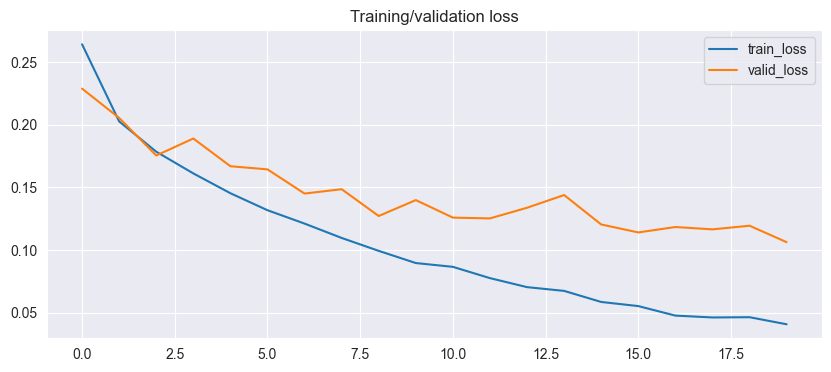

In [116]:
plt.figure(figsize=(10,4))
plt.plot(range(num_epochs), train_loss, label='train_loss')
plt.plot(range(num_epochs), valid_loss, label='valid_loss')
plt.legend(labels=['train_loss','valid_loss'])
plt.title("Training/validation loss")
plt.show()

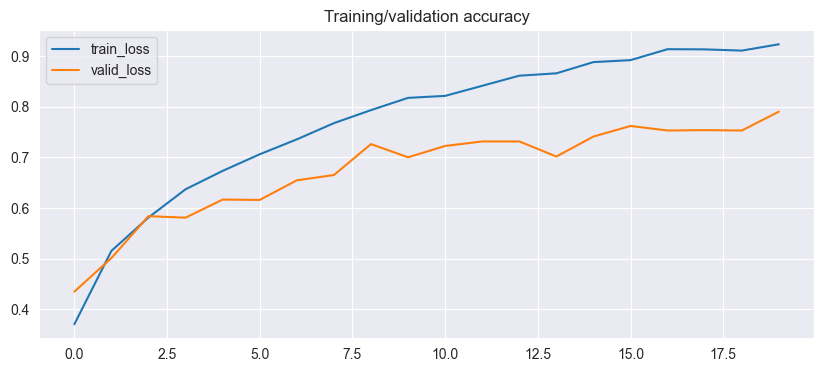

In [117]:
plt.figure(figsize=(10,4))
plt.plot(range(num_epochs), acc_train, label='train_acc')
plt.plot(range(num_epochs), acc_val, label='valid_acc')
plt.legend(labels=['train_loss','valid_loss'])
plt.title("Training/validation accuracy")
plt.show()

# Inference on the testing data where more than one instrument can be

In [118]:
inference_dir="/IRMAS-TestingData-Part2/IRTestingData-Part2/"
inf_audio=[]
inf_labels=[]
inf_files=os.listdir(f"{download_path}{inference_dir}")
for file_name in inf_files:
        if "txt" in file_name:
            with open(f"{download_path}{inference_dir}"+file_name, encoding = 'utf-8') as f:
                contents = f.read().splitlines()
                labels=[]
                for line in contents:
                    labels.append(labels_dict[line[:-1]])
            #as we have multi-label classification
            one_hot=torch.zeros(1,num_classes) #one-hot encoding for classes [1,1,0,0,....] = cel + cla
            one_hot[0,labels]=1
            inf_labels.append(one_hot)
        elif "wav" in file_name:
            inf_audio.append(inference_dir+file_name)


inf_df=pd.DataFrame({'relative_path': inf_audio, 'label': inf_labels})

In [119]:
inf_df

,relative_path,label
0,/IRMAS-TestingData-Part2/IRTestingData-Part2/0...,"[[tensor(0.), tensor(0.), tensor(0.), tensor(1..."
1,/IRMAS-TestingData-Part2/IRTestingData-Part2/0...,"[[tensor(0.), tensor(0.), tensor(0.), tensor(0..."
2,/IRMAS-TestingData-Part2/IRTestingData-Part2/0...,"[[tensor(0.), tensor(0.), tensor(0.), tensor(1..."
3,/IRMAS-TestingData-Part2/IRTestingData-Part2/0...,"[[tensor(0.), tensor(0.), tensor(0.), tensor(1..."
4,/IRMAS-TestingData-Part2/IRTestingData-Part2/0...,"[[tensor(0.), tensor(0.), tensor(0.), tensor(1..."
...,...,...
1296,/IRMAS-TestingData-Part2/IRTestingData-Part2/Z...,"[[tensor(0.), tensor(0.), tensor(1.), tensor(1..."
1297,/IRMAS-TestingData-Part2/IRTestingData-Part2/Z...,"[[tensor(0.), tensor(0.), tensor(1.), tensor(1..."
1298,/IRMAS-TestingData-Part2/IRTestingData-Part2/Z...,"[[tensor(0.), tensor(0.), tensor(1.), tensor(0..."
1299,/IRMAS-TestingData-Part2/IRTestingData-Part2/Z...,"[[tensor(0.), tensor(0.), tensor(1.), tensor(0..."


In [126]:
#choose 10 random records from TestData-Part3
num=10

random.seed(2022)

indexes=np.random.choice(range(inf_df.shape[0]), size=num)
print(indexes)

indexed_df=inf_df.iloc[indexes]

indexed_df.reset_index(inplace=True, drop=True)



data_path='IRMAS'
inf_ds = SoundDS(indexed_df, data_path)

print(f"size of validation data set {len(inf_ds)}")


# Create training and validation data loaders
inf_dl = torch.utils.data.DataLoader(inf_ds, batch_size=1, shuffle=True)

[ 212  458  601  489  314 1079  427  833  590    7]
size of validation data set 10


In [127]:
for j, data in enumerate(inf_dl):
    inputs, labels = data[0].to(device), data[1].to(device)

    labels.squeeze_() #delete butch size
      # Normalize the inputs
    inputs_m, inputs_s = inputs.mean(), inputs.std()
    inputs = (inputs - inputs_m) / inputs_s

      # Get predictions
    outputs = model(inputs)

# Get the predicted class probabilities
    outputs = torch.sigmoid(outputs)

    outputs = outputs.detach().numpy()



    target_indices = [i for i in range(len(labels)) if labels[i] == 1]

    sorted_indices = np.argsort(outputs[0])
    best = sorted_indices[-len(target_indices):] #take the biggest probabilities the same number as target instruments
    predicted=np.zeros_like(labels)
    predicted[best]=1

    # print(predicted)
    # print(labels)

    target_set=set(target_indices)  #set of indexes of target instruments e.g. {1,4,6}
    pred_set=set(best) #set of indexes of predicted instruments e.g. {2,4,6}

    correct=len(target_set.intersection(pred_set)) #intersection of the sets of indexes ->{4,6}
    total_num=len(target_set)

    # accuracy = len(intersection)/len(target) = 2/3
    print(f"accuracy for a record: {correct/total_num:.2f}")


    string_predicted = ''
    string_actual = ''
    for i in range(len(best)):
        string_predicted += f"{inverse_dict[best[i]]}   "
    for i in range(len(target_indices)):
        string_actual += f"{inverse_dict[target_indices[i]]}  "


    print(f"actual instruments: {string_actual}")
    print(f"predicted instruments: {string_predicted}")


    play_audio(f"{download_path}"+inf_df.iloc[indexes[j]]['relative_path'])


accuracy for a record: 0.00
actual instruments: gac  
predicted instruments: cla   


accuracy for a record: 0.00
actual instruments: pia  voi  
predicted instruments: vio   cla   


accuracy for a record: 1.00
actual instruments: voi  
predicted instruments: voi   


accuracy for a record: 1.00
actual instruments: pia  
predicted instruments: pia   


accuracy for a record: 1.00
actual instruments: voi  
predicted instruments: voi   


accuracy for a record: 1.00
actual instruments: gac  
predicted instruments: gac   


accuracy for a record: 1.00
actual instruments: gel  voi  
predicted instruments: voi   gel   


accuracy for a record: 0.50
actual instruments: pia  vio  
predicted instruments: vio   sax   


accuracy for a record: 0.00
actual instruments: pia  vio  
predicted instruments: gac   org   


accuracy for a record: 0.50
actual instruments: gac  org  
predicted instruments: org   flu   
